# Supplementary material
# On model development
<br>

The search for good decoder and autoencoder architecture starts with inference gained from two publications and knowledge from the community.
<br>

The first publication is a wonderful investigation of guiding principles in convolutional architectures for image classification, called **Designing network design spaces** by Radosavovic *et al.* 2020 (referenced in our paper).
<br>

The other architecture we investigated is taken from **Unsupervised representation learning with deep convolutional generative adversarial networks** by Radford *et al.* 2016.
<br>
<br>

We performed a search for well-performing models twice. In the first run, we searched for a good decoder starting from a representation of size *(channels, 1, 1)*. The second time, we searched for a good autoencoder, disregarding the decoder's performance and accepting larger-dimensional representations.
<br>
<br>

---
<br>

## Guiding principles / search space limitation derived from *Radosavovic et al. 2020*

1. Architectures are based on convolutional blocks
2. The number of channels (from encoder perspective) per stage have to follow rule $c_{i+1} >= c_{i}$
3. Apply same increase restriction to the number of blocks per stage (our additional limitation)

In the paper (based on previous research), the kernel size is restricted to 3 with stride 1. We additionally try kernel size 4 with stride 2 as seen in other works (*Radford et al. 2016* among them).
<br>
<br>

## Architecture from *Radford et al. 2016*

The decoder architecture is taken from the generator.
<br>
<br>

## Testing many architectures in a short time

Inspired by *Radosavovic et al. 2020*, in the broad model tests we train and test each model only for 10 epochs on subsets of the CIFAR10 train-test split. We use 100 samples per class from the train and 20 samples per class from the test set.

In [1]:
# insert your own directory to a designated folder on drive

direc = '/content/drive/MyDrive/Work/DGML/designing_design_space/'

# Imports and Functions

In [2]:
import sys
import os
import math
import random

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.distributions as D

import torchvision
from torchvision import transforms
from torchsummary import summary

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
import seaborn as sns

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

## Functions

### Data-related

In [3]:
transform = torchvision.transforms.Compose([torchvision.transforms.ToTensor()])

class CIFAR10_Dataset(torch.utils.data.Dataset):
    '''
    Commonly used class to get CIFAR10 dataset.
    Although one could now also just use the pytorch implementation
    torchvision.datasets.CIFAR10()
    '''
    def __init__(self, nsample=1000, train=True):
      super(CIFAR10_Dataset, self).__init__()
      self.data = torchvision.datasets.CIFAR10(root='./data', train=train,
                                          download=True, transform=transform)
      self.nsample = len(self.data)

    def __getitem__(self, index):
      data, target = self.data[index]
      return data, target, index

    def __len__(self):
      return self.nsample

# CIFAR10 classes in order of integers
classes = ('plane', 'car', 'bird', 'cat', 'deer',
           'dog', 'frog', 'horse', 'ship', 'truck')

def find_matching_index(idx, a):
    '''
    This function is used in training when using a subset of the data.
    It allows us to match the representation id to the subset id
    (which is still the original data id).
    '''
    return [np.where(idx == x)[0][0] for x in a]

def balanced_subset_list(t_set, step):
    '''
    We want CIFAR10 subsets not to be randomly sampled but balanced in terms of
    images per class. This function gets each classes' image ids and samples
    every STEP's image id.
    '''
    labels = [classes[x[1]] for x in t_set.data]
    unique_classes = list(set(labels))
    id_position_out = np.zeros(len(labels))
    for lbl in unique_classes:
        ids = [x for x in range(len(labels)) if labels[x] == lbl]
        keep = [ids[x] for x in range(len(ids)) if x % step == 0]
        id_position_out[keep] = 1
    out = list(np.where(id_position_out == 1)[0])
    return out

### Model classes

In [12]:
class DecoderModule(nn.Module):
    '''
    Decoder module starting from a channel x 1 x 1 tensor.
    Channel steps are defined by a defined basis called capacity
    which is doubled every second layer (output to input).
    Decoders are build with ConvTranspose layers.
    '''
    def __init__(self,c):
        super(DecoderModule, self).__init__()
        self.capacity = c

        self.cnn = nn.Sequential(
          nn.ConvTranspose2d(in_channels=c*4, out_channels=c*2, kernel_size=4, stride=2, padding=0),
          nn.BatchNorm2d(c*2),
          nn.ReLU(inplace=True),
          nn.ConvTranspose2d(in_channels=c*2, out_channels=c*2, kernel_size=4, stride=2, padding=1),
          nn.BatchNorm2d(c*2),
          nn.ReLU(inplace=True),
          nn.ConvTranspose2d(in_channels=c*2, out_channels=c, kernel_size=4, stride=2, padding=1),
          nn.BatchNorm2d(c),
          nn.ReLU(inplace=True),
          nn.ConvTranspose2d(in_channels=c, out_channels=c, kernel_size=4, stride=2, padding=1),
          nn.BatchNorm2d(c),
          nn.ReLU(inplace=True),
          nn.ConvTranspose2d(in_channels=c, out_channels=3, kernel_size=1, stride=1, padding=0),
          nn.Sigmoid()
          )
        
    def forward(self, x):
        x = self.cnn(x)
        return x

class DecoderModule2(nn.Module):
    '''
    Same as DecoderModule except for capacity multiplier in first two layers.
    Starts with a capacity*8 x 1 x 1 tensor.
    '''
    def __init__(self,c):
        super(DecoderModule2, self).__init__()
        self.capacity = c

        self.cnn = nn.Sequential(
          nn.ConvTranspose2d(in_channels=c*8, out_channels=c*4, kernel_size=4, stride=2, padding=0),
          nn.BatchNorm2d(c*4),
          nn.ReLU(inplace=True),
          nn.ConvTranspose2d(in_channels=c*4, out_channels=c*2, kernel_size=4, stride=2, padding=1),
          nn.BatchNorm2d(c*2),
          nn.ReLU(inplace=True),
          nn.ConvTranspose2d(in_channels=c*2, out_channels=c, kernel_size=4, stride=2, padding=1),
          nn.BatchNorm2d(c),
          nn.ReLU(inplace=True),
          nn.ConvTranspose2d(in_channels=c, out_channels=c, kernel_size=4, stride=2, padding=1),
          nn.BatchNorm2d(c),
          nn.ReLU(inplace=True),
          nn.ConvTranspose2d(in_channels=c, out_channels=3, kernel_size=1, stride=1, padding=0),
          nn.Sigmoid()
          )
        
    def forward(self, x):
        x = self.cnn(x)
        return x

class Decoder(nn.Module):
    '''
    Decoder takes decoder model and only adds a step in which to make sure
    to have the input in the right format. This is needed when using the decoder
    only to reshape the 1D representation vector into a 3D tensor.
    '''
    def __init__(self,c):
        super(Decoder, self).__init__()
        self.capacity = c

        self.dec = DecoderModule(c=c)
        
    def forward(self, x):
        x = x.view(x.size(0), self.capacity*4, 1, 1) # unflatten batch of feature vectors to a batch of multi-channel feature maps
        x = self.dec(x)
        return x

class DecoderFC(nn.Module):
    '''
    Similar to Decoder class but with additional fully connected layer in front
    of the CNN decoder module. This also uses a decoder module with larger channels
    and thus more parameters being connected to the final latent dimension.
    '''
    def __init__(self,c,latent_dim):
        super(DecoderFC, self).__init__()
        self.capacity = c

        self.fc = nn.Sequential(
            nn.Linear(in_features=latent_dim, out_features=c*8),
            nn.ReLU(True)
        )

        self.dec = DecoderModule2(c=c)
        
    def forward(self, x):
        x = self.fc(x)
        x = x.view(x.size(0), self.capacity*8, 1, 1) # unflatten batch of feature vectors to a batch of multi-channel feature maps
        x = self.dec(x)
        return x

class EncoderModule(nn.Module):
    '''
    Inverse of DecoderModule. Using Conv layers here.
    '''
    def __init__(self,c):
        super(EncoderModule, self).__init__()
        self.capacity = c
        self.cnn = nn.Sequential(
          nn.Conv2d(in_channels=3, out_channels=c, kernel_size=1, stride=1, padding=0),
          nn.BatchNorm2d(c),
          nn.ReLU(inplace=True),
          nn.Conv2d(in_channels=c, out_channels=c, kernel_size=4, stride=2, padding=1),
          nn.BatchNorm2d(c),
          nn.ReLU(inplace=True),
          nn.Conv2d(in_channels=c, out_channels=c*2, kernel_size=4, stride=2, padding=1),
          nn.BatchNorm2d(c*2),
          nn.ReLU(inplace=True),
          nn.Conv2d(in_channels=c*2, out_channels=c*2, kernel_size=4, stride=2, padding=1),
          nn.BatchNorm2d(c*2),
          nn.ReLU(inplace=True),
          nn.Conv2d(in_channels=c*2, out_channels=c*4, kernel_size=4, stride=2, padding=0),
          nn.ReLU(True))
            
    def forward(self, x):
        x = self.cnn(x)
        return x

class AE(nn.Module):
    '''Autoencoder built from encoder module and decoder module'''
    def __init__(self,c):
        super(AE, self).__init__()

        self.capacity = c

        self.enc = EncoderModule(c=c)
        self.dec = DecoderModule(c=c)

    def forward(self, x):
        z = self.enc(x)
        y = self.dec(z)
        return y

class DecoderModule_shallow(nn.Module):
    '''
    Decoder module starting with a 4 x 4 tensor, 
    thus called shallow in comparison to the previous decoder module
    '''
    def __init__(self,c):
        super(DecoderModule_shallow, self).__init__()
        self.capacity = c

        self.cnn = nn.Sequential(
          nn.ConvTranspose2d(in_channels=c*4, out_channels=c*4, kernel_size=4, stride=2, padding=1),
          nn.BatchNorm2d(c*4),
          nn.ReLU(inplace=True),
          nn.ConvTranspose2d(in_channels=c*4, out_channels=c*2, kernel_size=4, stride=2, padding=1),
          nn.BatchNorm2d(c*2),
          nn.ReLU(inplace=True),
          nn.ConvTranspose2d(in_channels=c*2, out_channels=c, kernel_size=4, stride=2, padding=1),
          nn.BatchNorm2d(c),
          nn.ReLU(inplace=True),
          nn.ConvTranspose2d(in_channels=c, out_channels=3, kernel_size=1, stride=1, padding=0),
          nn.Sigmoid()
          )
        
    def forward(self, x):
        x = x.view(x.size(0), self.capacity*4, 4, 4) # unflatten batch of feature vectors to a batch of multi-channel feature maps
        x = self.cnn(x)
        return x

class EncoderModule_shallow(nn.Module):
    def __init__(self,c):
        super(EncoderModule_shallow, self).__init__()
        self.capacity = c
        self.cnn = nn.Sequential(
          nn.Conv2d(in_channels=3, out_channels=c, kernel_size=1, stride=1, padding=0),
          nn.BatchNorm2d(c),
          nn.ReLU(inplace=True),
          nn.Conv2d(in_channels=c, out_channels=c*2, kernel_size=4, stride=2, padding=1),
          nn.BatchNorm2d(c*2),
          nn.ReLU(inplace=True),
          nn.Conv2d(in_channels=c*2, out_channels=c*4, kernel_size=4, stride=2, padding=1),
          nn.BatchNorm2d(c*4),
          nn.ReLU(inplace=True),
          nn.Conv2d(in_channels=c*4, out_channels=c*4, kernel_size=4, stride=2, padding=1),
          nn.ReLU(True)
          )
        
    def forward(self, x):
        x = self.cnn(x)
        return x

class AE_shallow(nn.Module):
    def __init__(self,c):
        super(AE_shallow, self).__init__()

        self.capacity = c

        self.enc = EncoderModule_shallow(c=c)
        self.dec = DecoderModule_shallow(c=c)

    def forward(self, x):
        z = self.enc(x)
        y = self.dec(z)
        return y

##############################
# model classes for Radosavovic et al. 2020
##############################

class Block(nn.Module):
  '''
  A convolutional block consists of 3 convolutional layers with batch 
  normalization and relu activation in between. The first and last layer
  do not reduce pixel dimensions as their kernel size is 1 with stride 1.
  The middle layer reduces pixel dimensions with kernel size k and the
  channel size is changed in the first layer.
  '''
  def __init__(self, in_chanl, out_chanl, k, groups):
    super(Block, self).__init__()
    self.in_chanl = in_chanl
    self.out_chanl = out_chanl
    self.groups = groups

    self.main = nn.Sequential(
        nn.Conv2d(in_channels=in_chanl, out_channels=out_chanl, kernel_size=1, stride=1),
        nn.BatchNorm2d(out_chanl),
        nn.ReLU(True),
        nn.Conv2d(in_channels=out_chanl, out_channels=out_chanl, kernel_size=k, stride=1, groups=groups),
        nn.BatchNorm2d(out_chanl),
        nn.ReLU(True),
        nn.Conv2d(in_channels=out_chanl, out_channels=out_chanl, kernel_size=1, stride=1),
        nn.BatchNorm2d(out_chanl),
        nn.ReLU(True)
    )

  def forward(self, x):
    x = self.main(x)
    return x

class BlockT(nn.Module):
  '''
  Inverse of Block element with ConvTranspose layers.
  '''
  def __init__(self, in_chanl, out_chanl, k, s=1, groups=1, relu=True, p=0):
    super(BlockT, self).__init__()
    self.in_chanl = in_chanl
    self.out_chanl = out_chanl
    self.groups = groups
    
    if relu:
      self.main = nn.Sequential(
          nn.ConvTranspose2d(in_channels=in_chanl, out_channels=out_chanl, kernel_size=1, stride=1),
          nn.BatchNorm2d(out_chanl),
          nn.ReLU(True),
          nn.ConvTranspose2d(in_channels=out_chanl, out_channels=out_chanl, kernel_size=k, stride=s, groups=groups, padding=p),
          nn.BatchNorm2d(out_chanl),
          nn.ReLU(True),
          nn.ConvTranspose2d(in_channels=out_chanl, out_channels=out_chanl, kernel_size=1, stride=1),
          nn.BatchNorm2d(out_chanl),
          nn.ReLU(True)
      )
    else:
      self.main = nn.Sequential(
        nn.ConvTranspose2d(in_channels=in_chanl, out_channels=out_chanl, kernel_size=1, stride=1),
        nn.BatchNorm2d(out_chanl),
        nn.ReLU(True),
        nn.ConvTranspose2d(in_channels=out_chanl, out_channels=out_chanl, kernel_size=k, stride=s, groups=groups, padding=p),
        nn.BatchNorm2d(out_chanl),
        nn.ReLU(True),
        nn.ConvTranspose2d(in_channels=out_chanl, out_channels=out_chanl, kernel_size=1, stride=1),
        nn.BatchNorm2d(out_chanl),
        nn.Sigmoid()
    )

  def forward(self, x):
    x = self.main(x)
    return x

class Encoder_Blocks(nn.Module):
  '''
  Encoder built by block elements. Stages, blocks and channel multiplier
  are included as variables for flexibility in model search.
  '''
  def __init__(self,stages,blocks,multiplier,start_chanl,groups):
    super(Encoder_Blocks, self).__init__()
    self.s_d = stages
    self.b_d = blocks
    self.m = multiplier
    self.g = groups

    self.layers = nn.ModuleList()

    # the stage defines the channel multiplier
    for i in range(self.s_d):
      if isinstance(self.b_d, int): # blocks can either be uniformly distributed or a specific sequence of length s_d
        for j in range(self.b_d):
          if j == 0: # the first block changes the channel size of the stage
            self.layers.append(Block(in_chanl=start_chanl*self.m**(i), out_chanl=start_chanl*self.m**(i+1), k=3, groups=self.g))
          else:
            self.layers.append(Block(in_chanl=start_chanl*self.m**(i+1), out_chanl=start_chanl*self.m**(i+1), k=3, groups=self.g))
      else:
        for j in range(self.b_d[i]):
          if j == 0: # the first block changes the channel size of the stage
            self.layers.append(Block(in_chanl=start_chanl*self.m**(i), out_chanl=start_chanl*self.m**(i+1), k=3, groups=self.g))
          else:
            self.layers.append(Block(in_chanl=start_chanl*self.m**(i+1), out_chanl=start_chanl*self.m**(i+1), k=3, groups=self.g))
    
    #self.layers.append(Block(in_chanl=start_chanl*self.m**(self.s_d), out_chanl=start_chanl*self.m**(self.s_d+1), k=2, groups=self.g))
        
  def forward(self, x):
    for layer in self.layers:
      x = layer(x)
    return x


class Decoder_BlocksFC(nn.Module):
  '''
  Decoder built by one fully connected layer and transposed block elements. Stages, blocks and channel multiplier
  are included as variables for flexibility in model search.
  '''
  def __init__(self,latent_dim,stages,blocks,multiplier,start_chanl,groups=1,k=3,s=1,p=0):
    super(Decoder_BlocksFC, self).__init__()
    self.start_chanl = start_chanl
    self.s_d = stages
    self.b_d = blocks
    self.m = multiplier
    self.g = groups
    self.k = k
    self.latent_dim = latent_dim

    self.fc = nn.Sequential(
        nn.Linear(in_features=latent_dim, out_features=start_chanl*self.m**(self.s_d+1)),
        nn.ReLU(True)
    )

    self.layers = nn.ModuleList()

    if k % 2 != 0:
      self.layers.append(BlockT(in_chanl=start_chanl*self.m**(self.s_d+1), out_chanl=start_chanl*self.m**(self.s_d), k=2, groups=self.g))
    else:
      self.layers.append(BlockT(in_chanl=start_chanl*self.m**(self.s_d+1), out_chanl=start_chanl*self.m**(self.s_d), k=1, groups=self.g))

    for i in range(self.s_d):
      if isinstance(self.b_d, int):
        for j in range(self.b_d):
          if j == 0:
            self.layers.append(BlockT(in_chanl=start_chanl*self.m**(self.s_d-i), out_chanl=start_chanl*self.m**(self.s_d-i-1), k=k, s=s, groups=self.g, p=p))
          elif (i == self.s_d - 1) & (j == self.b_d - 1):
            self.layers.append(BlockT(in_chanl=start_chanl*self.m**(self.s_d-i-1), out_chanl=start_chanl*self.m**(self.s_d-i-1), k=k, s=s, groups=self.g, relu=False, p=p))
          else:
            self.layers.append(BlockT(in_chanl=start_chanl*self.m**(self.s_d-i-1), out_chanl=start_chanl*self.m**(self.s_d-i-1), k=k, s=s, groups=self.g, p=p))
      else:
        for j in range(self.b_d[i]):
          if j == 0:
            self.layers.append(BlockT(in_chanl=start_chanl*self.m**(self.s_d-i), out_chanl=start_chanl*self.m**(self.s_d-i-1), k=k, s=s, groups=self.g, p=p))
          elif (i == self.s_d - 1) & (j == self.b_d[i] - 1):
            self.layers.append(BlockT(in_chanl=start_chanl*self.m**(self.s_d-i-1), out_chanl=start_chanl*self.m**(self.s_d-i-1), k=k, s=s, groups=self.g, relu=False, p=p))
          else:
            self.layers.append(BlockT(in_chanl=start_chanl*self.m**(self.s_d-i-1), out_chanl=start_chanl*self.m**(self.s_d-i-1), k=k, s=s, groups=self.g, p=p))
        
  def forward(self, x):
    x = self.fc(x)
    x = x.view(x.size(0), self.start_chanl*self.m**(self.s_d+1), 1, 1)
    for layer in self.layers:
      x = layer(x)
    return x

class Decoder_Blocks(nn.Module):
  '''
  Decoder built by block elements. Stages, blocks and channel multiplier
  are included as variables for flexibility in model search.
  '''
  def __init__(self,stages,blocks,multiplier,start_chanl,groups=1,k=3,s=1,p=0,decoder_alone=False):
    super(Decoder_Blocks, self).__init__()
    self.start_chanl = start_chanl
    self.s_d = stages
    self.b_d = blocks
    self.m = multiplier
    self.g = groups
    self.k = k
    self.decoder_alone = decoder_alone

    self.layers = nn.ModuleList()

    for i in range(self.s_d):
      if isinstance(self.b_d, int):
        for j in range(self.b_d):
          if j == 0:
            self.layers.append(BlockT(in_chanl=start_chanl*self.m**(self.s_d-i), out_chanl=start_chanl*self.m**(self.s_d-i-1), k=k, s=s, groups=self.g, p=p))
          elif (i == self.s_d - 1) & (j == self.b_d - 1):
            self.layers.append(BlockT(in_chanl=start_chanl*self.m**(self.s_d-i-1), out_chanl=start_chanl*self.m**(self.s_d-i-1), k=k, s=s, groups=self.g, relu=False, p=p))
          else:
            self.layers.append(BlockT(in_chanl=start_chanl*self.m**(self.s_d-i-1), out_chanl=start_chanl*self.m**(self.s_d-i-1), k=k, s=s, groups=self.g, p=p))
      else:
        for j in range(self.b_d[i]):
          if j == 0:
            self.layers.append(BlockT(in_chanl=start_chanl*self.m**(self.s_d-i), out_chanl=start_chanl*self.m**(self.s_d-i-1), k=k, s=s, groups=self.g, p=p))
          elif (i == self.s_d - 1) & (j == self.b_d[i] - 1):
            self.layers.append(BlockT(in_chanl=start_chanl*self.m**(self.s_d-i-1), out_chanl=start_chanl*self.m**(self.s_d-i-1), k=k, s=s, groups=self.g, relu=False, p=p))
          else:
            self.layers.append(BlockT(in_chanl=start_chanl*self.m**(self.s_d-i-1), out_chanl=start_chanl*self.m**(self.s_d-i-1), k=k, s=s, groups=self.g, p=p))
        
  def forward(self, x):
    if self.decoder_alone:
      x = x.view(x.size(0), self.start_chanl*self.m**(self.s_d+1), 1, 1)
    for layer in self.layers:
      x = layer(x)
    return x

class AE_Blocks(nn.Module):
  def __init__(self,stages,blocks,multiplier,start_chanl,groups=1,k=3,s=1,p=0):
    super(AE_Blocks, self).__init__()

    blocks_decoder = [blocks[stages-i-1] for i in range(stages)]

    self.enc = Encoder_Blocks(stages,blocks,multiplier,start_chanl,groups)
    self.dec = Decoder_Blocks(stages,blocks_decoder,multiplier,start_chanl,groups,k,s,p)
  
  def forward(self, x):
    x = self.enc(x)
    x = self.dec(x)
    return x

In [13]:
class RepresentationLayer(torch.nn.Module):
  '''
  Implements a representation layer, that accumulates pytorch gradients.
  To update representation, the pytorch framework does not work well, so
  the module comes with it's own SGD update (self.update(lr,mom,...)).
  Do not forget to call zero_grad after an epoch
  '''
  def __init__(self, nrep, nsample,
                rep_activity=(1.,1.),      # Normal distribution mean and stddev
                norm=True                  # Normalize representation
              ):
    super(RepresentationLayer, self).__init__()
    self.nrep=nrep
    self.nsample=nsample
    self.mean, self.stddev = rep_activity[0],rep_activity[1]
    self.norm = norm
    self.init_rep(rep_activity[0],rep_activity[1])
    self.dz = None

  def init_rep(self,mean,stddev):
    # Generate random activities
    self.z = torch.nn.Parameter(torch.normal(mean,stddev,size=(self.nsample,self.nrep), requires_grad=True))
    #self.clamp()

  def clamp(self):
    with torch.no_grad():
      if self.norm:
        self.z.clamp_(min=0)
        norm = 1./self.z.mean()
        self.z.mul_(norm)
      else:
        self.z.clamp_(min=0)

  def zero_grad(self):
    if self.z.grad is not None:
      self.z.grad.detach_()
      self.z.grad.zero_()

  def fix(self):
    self.z.requires_grad = False

  def unfix(self):
    self.z.requires_grad = True

  def forward(self, idx):
    if idx is None:
      return self.z
    else:
      return self.z[idx]

  # Index can be whatever it can be for a torch.tensor (e.g. tensor of idxs)
  def __getitem__(self,index):
    return self.z[index]

  def update(self,idx,lr=0.001,mom=0.9,wd=None):
    device = self.z.device
    if self.dz is None:
      self.dz = torch.zeros(self.z.size()).to(device)
    with torch.no_grad():
      # Update z
      # dz(k,j) = sum_i grad(k,i) w(i,j) step(z(j))
      self.dz[idx] = self.dz[idx].mul(mom) - self.z.grad[idx].mul(lr)
      if wd is not None:
        self.dz[idx] -= wd*self.z[idx]
      self.z[idx] += self.dz[idx]
      #self.clamp()

### Training

In [6]:
def set_random_seed(seed):
    torch.manual_seed(seed)
    np.random.seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed_all(seed)

def round_down(x):
  y = round(x)
  if y > x:
    return y - 1
  else:
    return y

def fill_block_position(len_remain,b_tot,b_last,b_current,list_in):
  '''
  Generate block lists for given stages
  '''
  if len_remain == 1:
    list_in.append(b_tot-b_current)
    return list_in
  max_size = round_down((b_tot-b_current)/len_remain)
  for i in range(b_last,max_size+1):
    list_in.append(i)
    return fill_block_position(len_remain-1,b_tot,i,b_current+i,list_in)

def count_params(model):
  num_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
  return num_params

def load_d(N,n,m,params):
  a = (N*n)/(params+N*m)
  return round(a, 4)

def load_e(N,n,params):
  a = (N*n)/(params)
  return round(a, 4)

In [17]:
def trainDecoder(data, nepocs, latent_dim, decoder,
                 lr=1e-3,lr_rep=1e-2,wd=0,mom=0.95,loss_type='mse',
                 indices_images=None, test_data=None, indices_images_test=None, plt_img=0):

  nsample = data.dataset.__len__()

  # init decoder
  decoder=decoder.to(device)
  # init representations and GMM
  representation = RepresentationLayer(latent_dim,nsample).to(device)
  if test_data != None:
    nsample_test = test_data.dataset.__len__()
    test_rep = RepresentationLayer(latent_dim,nsample_test).to(device)
  # optimizers
  decoder_optimizer = torch.optim.Adam(decoder.parameters(), lr=lr, weight_decay=wd)
  
  if loss_type == 'mse':
    criterion = nn.MSELoss(reduction='sum')
  elif loss_type == 'bce':
    criterion = nn.BCELoss(reduction='sum')
  else:
    print('please specify proper loss name. Options are mse and bce')

  train_avg = []
  test_avg = []

  for epoch in range(nepocs):
    train_avg.append(0)
    num_batches = 0

    representation.zero_grad()
    for x, t, i in data:
      decoder_optimizer.zero_grad()
      x = x.to(device)

      # compute reconstructions
      if indices_images != None:
        pos = find_matching_index(indices_images,i.numpy())
        z = representation(pos)
      else:
        z = representation(i)
      y = decoder(z)

      # compute loss
      loss = criterion(y,x)
      loss.backward()

      #representation_optimizer.step()
      if indices_images != None:
        representation.update(pos,lr=lr_rep,mom=mom)
      else:
        representation.update(i,lr=lr_rep,mom=mom)
      decoder_optimizer.step()
    
      train_avg[-1] += loss.item()
      num_batches += 1
    train_avg[-1] /= nsample*input_dims

    if test_data != None:
      test_avg.append(0)
      num_batches = 0

      test_rep.zero_grad()
      for x, t, i in test_data:
        decoder_optimizer.zero_grad()
        x = x.to(device)

        # compute reconstructions
        if indices_images_test != None:
          pos = find_matching_index(indices_images_test,i.numpy())
          z = test_rep(pos)
        else:
          z = test_rep(i)
        y = decoder(z)

        # compute loss
        loss = criterion(y,x)
        loss.backward()

        #representation_optimizer.step()
        if indices_images_test != None:
          test_rep.update(pos,lr=lr_rep,mom=mom)
        else:
          test_rep.update(i,lr=lr_rep,mom=mom)
      
        test_avg[-1] += loss.item()
        num_batches += 1
      test_avg[-1] /= nsample_test*input_dims
  
  if plt_img == 0:
    return train_avg
  else:
    final_metrics = pd.DataFrame({'epoch': np.arange(nepocs),
                                  'loss': train_avg,
                                  'type': 'train'
                                  })
    final_metrics = final_metrics.append(pd.DataFrame({'epoch': np.arange(nepocs),
                                                        'loss':test_avg,
                                                        'type': 'test'
                                                        }))
    return decoder, representation, test_rep, final_metrics

def trainAE(data,testdata,nepocs, model,
                 lr=1e-3,wd=0,loss_type='mse',l1_alpha=0,
                 pr=1,indices_images=None,indices_images_test=None,plt_img=0):

  nsample = data.dataset.__len__()
  nsample_test = testdata.dataset.__len__()

  model=model.to(device)
  
  # optimizers
  optimizer = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=wd)
  
  if loss_type == 'mse':
    criterion = nn.MSELoss(reduction='sum')
  elif loss_type == 'bce':
    criterion = nn.BCELoss(reduction='sum')
  else:
    print('please specify proper loss name. Options are mse and bce')
  #l1 = nn.L1Loss(reduction='sum')

  train_avg = []
  test_avg = []
  for epoch in range(nepocs):
    train_avg.append(0)
    test_avg.append(0)
    num_batches = 0

    for x, t, i in data:
      optimizer.zero_grad()
      x = x.to(device)
      y = model(x)
      #print(y.shape)

      # compute loss
      loss = criterion(y,x)
      loss.backward()

      optimizer.step()
    
      train_avg[-1] += loss.item()
      num_batches += 1
    train_avg[-1] /= nsample*input_dims

    num_batches = 0
    for x, t, i in testdata:
      optimizer.zero_grad()
      x = x.to(device)
      y = model(x)

      # compute loss
      loss = criterion(y,x)
      loss.backward()
    
      test_avg[-1] += loss.item()
      num_batches += 1
    test_avg[-1] /= nsample_test*input_dims
  
  final_metrics = pd.DataFrame({'epoch': np.arange(nepocs),
                                  'loss': train_avg,
                                  'type': 'train'
                                  })
  final_metrics = final_metrics.append(pd.DataFrame({'epoch': np.arange(nepocs),
                                                      'loss':test_avg,
                                                      'type': 'test'
                                                      }))
  #if pr:
  #  sns.lineplot(data=final_metrics, x='epoch', y='loss', hue='type')
  #  plt.show()
  #  print('train loss {}, test loss {}'.format(round(train_avg[-1],4),round(test_avg[-1],4)))
  if plt_img == 1:
    return model, final_metrics
  else:
    return final_metrics

### Visualization

In [8]:
def to_img(x):
    x = x.clamp(0, 1)
    return x

def show_image(img, a=None):
    img = to_img(img)
    npimg = img.numpy()
    if a is not None:
      a.imshow(np.transpose(npimg, (1, 2, 0)))
    else:
      plt.imshow(np.transpose(npimg, (1, 2, 0)))

def rep_recon_plot_ae(train_set, test_set, model, data_type='full', indices_images=None, indices_images_test=None):
    '''
    Visualize the first 16 images reconstructed by the AE
    '''
    fig, ax = plt.subplots(figsize=(20,5), ncols=4)

    with torch.no_grad():
        img_recon = []
        test_img_recon = []
        images_list = []
        images_test_list = []
        for i in range(16):
            if data_type == 'subset':
              idx = indices_images[i]
              img_recon.append(model(train_set.dataset.data[idx][0].unsqueeze(0).to(device)).squeeze(0).detach().cpu())
              images_list.append(train_set.dataset.data[idx][0])
              idx = indices_images_test[i]
              test_img_recon.append(model(test_set.dataset.data[idx][0].unsqueeze(0).to(device)).squeeze(0).detach().cpu())
              images_test_list.append(test_set.dataset.data[idx][0])
            else:
              img_recon.append(model(train_set.data[i][0].unsqueeze(0).to(device)).squeeze(0).detach().cpu())
              test_img_recon.append(model(test_set.data[i][0].unsqueeze(0).to(device)).squeeze(0).detach().cpu())
              images_list.append(train_set.data[i][0])
              images_test_list.append(test_set.data[i][0])

    ax[0].set_title('reconstructed train images')
    show_image(torchvision.utils.make_grid(img_recon,4,4),a=ax[0])
    ax[1].set_title('original train images')
    show_image(torchvision.utils.make_grid(images_list,4,4),a=ax[1])

    ax[2].set_title('reconstructed test images')
    show_image(torchvision.utils.make_grid(test_img_recon,4,4),a=ax[2])
    ax[3].set_title('original test images')
    show_image(torchvision.utils.make_grid(images_test_list,4,4),a=ax[3])
    plt.show()

def rep_recon_plot_decoder(train_set, test_set, decoder, rep, test_rep, data_type='full', indices_images=None, indices_images_test=None):
    '''
    Visualize the first 16 images reconstructed by the decoder
    '''
    fig, ax = plt.subplots(figsize=(20,5), ncols=4)

    with torch.no_grad():
        # reconstruct images from the representation
        img_recon = decoder(rep.z[:16,:]).detach().cpu()
        test_img_recon = decoder(test_rep.z[:16,:]).detach().cpu()

    images_list = []
    images_test_list = []
    for i in range(16):
        if data_type == 'subset':
          idx = indices_images[i]
          images_list.append(train_set.dataset.data[idx][0])
          idx = indices_images_test[i]
          images_test_list.append(test_set.dataset.data[idx][0])
        else:
          images_list.append(train_set.data[i][0])
          images_test_list.append(test_set.data[i][0])

    ax[0].set_title('reconstructed train images')
    show_image(torchvision.utils.make_grid(img_recon.data[:16],4,4),a=ax[0])
    ax[1].set_title('original train images')
    show_image(torchvision.utils.make_grid(images_list,4,4),a=ax[1])

    ax[2].set_title('reconstructed test images')
    show_image(torchvision.utils.make_grid(test_img_recon.data[:16],4,4),a=ax[2])
    ax[3].set_title('original test images')
    show_image(torchvision.utils.make_grid(images_test_list,4,4),a=ax[3])
    plt.show()

# Load Data

Subsample every 50th image per class from both train and test split provided by CIFAR10. This results in 100 train and 20 test images per class.

In [9]:
batch_size = 64
test_batch_size = 16
input_dims = 32*32*3

###

trainset = CIFAR10_Dataset(train=True)
testset = CIFAR10_Dataset(train=False)

sample_step = 50
trainset_1 = torch.utils.data.Subset(trainset, balanced_subset_list(trainset, sample_step))
testset_1 = torch.utils.data.Subset(testset, balanced_subset_list(testset, sample_step))

print('{} samples per class in train'.format(round(trainset_1.__len__()/10)))
print('{} samples per class in test'.format(round(testset_1.__len__()/10)))

trainloader = torch.utils.data.DataLoader(trainset_1, batch_size=batch_size,
                                          shuffle=True, num_workers=2)
testloader = torch.utils.data.DataLoader(testset_1, batch_size=test_batch_size,
                                          shuffle=True, num_workers=2)

  0%|          | 0/170498071 [00:00<?, ?it/s]

Extracting ./data/cifar-10-python.tar.gz to ./data
Files already downloaded and verified
100 samples per class in train
20 samples per class in test


# Model Search for Decoder

## Selecting a model based on *Radosavovic et al. 2020*

### 1st run (broad)

In [3]:
# Hyperparameters for models from Radosavovic 2020

# number of blocks per stage
kernel_block_options = [[1,1,3],
                        [1,2,2],
                        [1,1,1,2],
                        [1,1,1,1,1],
                        [3,5,7],
                        [1,2,4,8],
                        [1,4,4,6],
                        [1,2,2,2,2,2,2,2]]

# factor by which channels will be multiplied each stage
channel_multiplier_options = [2,3,4]

# size of latent dimension to project CNN output to
latent_dimension_options = [2, 8, 32, 64, 128, 256]

# weight decay for adam optimizer
wd = 1e-5

n_epochs = 10

In [ ]:
# create file that enables to get design parameters from model id
count = 0
for b in kernel_block_options:
  for m in channel_multiplier_options:
    for l in latent_dimension_options:
      # the number of blocks depends on the kernel and stride sizes
      # in order to achieve a representation of (channels, 1, 1)
      if sum(b) == 5:
        k = 4
        s = 2
        p = 1
      elif sum(b) == 15:
        k = 3
        s = 1
        p = 0
      meta_out = pd.DataFrame({'id': [count],
                                'stages': len(b),
                                'blocks': str(b),
                                'channel_multiplier': m,
                                'groups': 1,
                                'latent': l,
                                'kernel': k,
                                'stride': s,
                                'padding': p
                                })
      if count == 0:
        meta_out.to_csv(direc+'meta_A.csv',index=False)
      else:
        meta_out.to_csv(direc+'meta_A.csv',mode='a',index=False,header=False)
      count += 1

# now train models
count = 0
for b in kernel_block_options:
  for m in channel_multiplier_options:
    for l in latent_dimension_options:
      g = 1 # only using 1 group in the convolutional layers
      # the number of blocks depends on the kernel and stride sizes
      # in order to achieve a representation of (channels, 1, 1)
      if sum(b) == 5:
        k = 4
        s = 2
        p = 1
      elif sum(b) == 15:
        k = 3
        s = 1
        p = 0
      else:
        print('error in block distributions')
      decoder = Decoder_BlocksFC(latent_dim=l,stages=len(b),blocks=b,multiplier=m,start_chanl=3,groups=g,k=k,s=s,p=p)

      train_history = trainDecoder(trainloader, nepocs=n_epochs,
                                          latent_dim=l, decoder=decoder,
                                          lr=lr_decoder, lr_rep=lr_rep, wd=wd, mom=0.9,
                                          indices_images=trainset_1.indices)
      history_out = pd.DataFrame({'loss': train_history,
                                  'epoch': range(n_epochs),
                                  'id': count
                                  })
      if count == 0:
        history_out.to_csv(direc+'history_A.csv',index=False)
      else:
        history_out.to_csv(direc+'history_A.csv',mode='a',index=False,header=False)
      
      count += 1

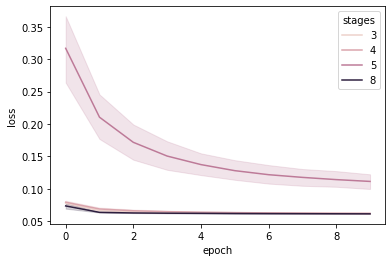

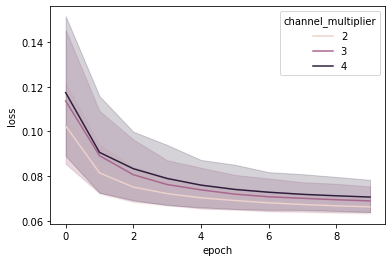

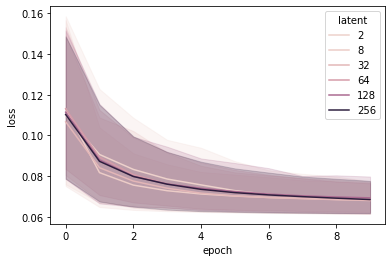

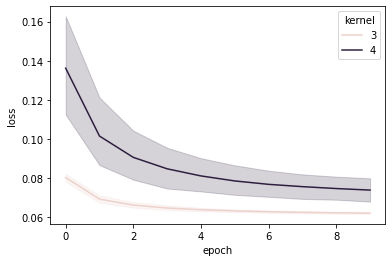

In [4]:
meta = pd.read_csv(direc + 'meta_A.csv')
history = pd.read_csv(direc + 'history_A.csv')

meta = meta[meta['id'] < 132] # large channel multiplier with high stage number results in a large number of parameters and exceeds a reasonable memory usage
meta = meta.loc[meta.index.repeat(n_epochs)]
meta['epoch'] = history['epoch'].values
meta['loss'] = history['loss'].values

# investigate influence of number of stages, latent dimensions and channel multipliers, and kernel size

investigate_1d = 'stages'
temp = meta[['loss', 'epoch', investigate_1d]].drop_duplicates()
sns.lineplot(data=temp, x='epoch', y='loss', hue=investigate_1d)
plt.show()

investigate_1d = 'channel_multiplier'
temp = meta[['loss', 'epoch', investigate_1d]].drop_duplicates()
sns.lineplot(data=temp, x='epoch', y='loss', hue=investigate_1d)
plt.show()

investigate_1d = 'latent'
temp = meta[['loss', 'epoch', investigate_1d]].drop_duplicates()
sns.lineplot(data=temp, x='epoch', y='loss', hue=investigate_1d)
plt.show()

investigate_1d = 'kernel'
temp = meta[['loss', 'epoch', investigate_1d]].drop_duplicates()
sns.lineplot(data=temp, x='epoch', y='loss', hue=investigate_1d)
plt.show()

These learning curves enable us to further reduce the search space. 5 stages seemed to achieve much higher losses and will thus be neglected. The latent dimension did not show any trend at this stage. For channel multiplier and kernel size, results indicate that a channel multiplier of 2 and kernel size of 3 are favourable.

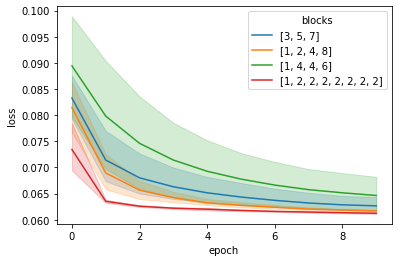

In [5]:
temp = meta[(meta['kernel']==3) & (meta['channel_multiplier']==2)]
sns.lineplot(data=temp, x='epoch', y='loss', hue='blocks')
plt.show()

A high stage number shows now improvement after the first two epochs and is thus also removed.

### 2nd run

Now limited to kernel size 3, channel multiplier 2 and stage number <= 4.
We are now also testing learning

In [18]:
# Limited hyperparameters

# number of blocks per stage
kernel_block_options = [[3,5,7],
                        [1,2,4,8],
                        [1,4,4,6]]

# size of latent dimension to project CNN output to
# limiting these right now to a smaller number for finding good learning curves quickly
latent_dimension_options = [2, 8, 32]

# learning rates for decoder and representation
lr_decoder_options = [1e-2,1e-3,1e-4,1e-5]
lr_rep_options = [1e-2,1e-3,1e-4,1e-5]

# weight decay for adam optimizer
wd = 1e-5

n_epochs = 10

In [19]:
count = 0

for b in kernel_block_options:
  for l in latent_dimension_options:
    for lr_decoder in lr_decoder_options:
      for lr_rep in lr_rep_options:
        decoder = Decoder_BlocksFC(latent_dim=l,stages=len(b),blocks=b,multiplier=2,start_chanl=3,groups=1,k=3,s=1,p=0)

        train_history = trainDecoder(trainloader, nepocs=n_epochs,
                                            latent_dim=l, decoder=decoder,
                                            lr=lr_decoder, lr_rep=lr_rep, wd=wd, mom=0.9,
                                            indices_images=trainset_1.indices)
        history_out = pd.DataFrame({'loss': train_history,
                                    'epoch': range(n_epochs),
                                    'id': count,
                                    'stages': len(b),
                                    'blocks': str(b),
                                    'channel_multiplier': 2,
                                    'latent': l,
                                    'lr_decoder': lr_decoder,
                                    'lr_rep': lr_rep
                                    })
        if count == 0:
          history_out.to_csv(direc + 'history_B.csv',index=False)
        else:
          history_out.to_csv(direc + 'history_B.csv',mode='a',index=False,header=False)
        
        count += 1

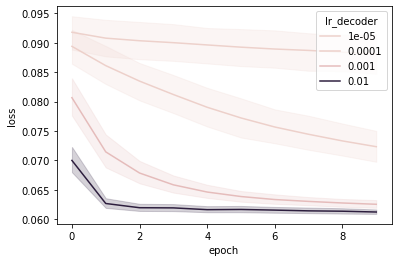

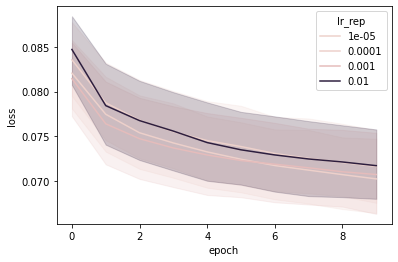

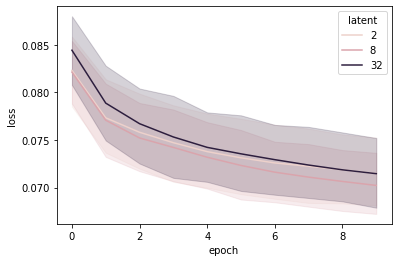

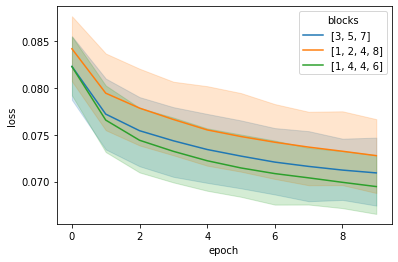

In [7]:
history = pd.read_csv(direc + 'history_B.csv')

sns.lineplot(data=history, x='epoch', y='loss', hue='lr_decoder')
plt.show()
# 1e-3 best

sns.lineplot(data=history, x='epoch', y='loss', hue='lr_rep')
plt.show()
# no clear trends

sns.lineplot(data=history, x='epoch', y='loss', hue='latent')
plt.show()
# no clear trends

sns.lineplot(data=history, x='epoch', y='loss', hue='blocks')
plt.show()
# potentially 1,4,4,6

### 3rd run (longer training)

In [ ]:
# Limited hyperparameters

# number of blocks per stage
b = [1,4,4,6]

# size of latent dimension to project CNN output to
# limiting these right now to a smaller number for finding good learning curves quickly
latent_dimension_options = [2, 8, 32]

# learning rates for decoder and representation
lr_decoder = 1e-3
lr_rep_options = [1e-2,1e-3,1e-4,1e-5]

# weight decay for adam optimizer
wd = 1e-5

n_epochs = 100

In [ ]:
count = 0

for l in latent_dimension_options:
  for lr_rep in lr_rep_options:
    decoder = Decoder_BlocksFC(latent_dim=l,stages=len(b),blocks=b,multiplier=2,start_chanl=3,groups=1,k=3,s=1,p=0)

    train_history = trainDecoder(trainloader, nepocs=n_epochs,
                                        latent_dim=l, decoder=decoder,
                                        lr=lr_decoder, lr_rep=lr_rep, wd=wd, mom=0.9,
                                        indices_images=trainset_1.indices)
    history_out = pd.DataFrame({'loss': train_history,
                                'epoch': range(n_epochs),
                                'id': count,
                                'stages': len(b),
                                'blocks': str(b),
                                'channel_multiplier': 2,
                                'latent': l,
                                'lr_decoder': lr_decoder,
                                'lr_rep': lr_rep
                                })
    if count == 0:
      history_out.to_csv(direc + 'history_B2.csv',index=False)
    else:
      history_out.to_csv(direc + 'history_B2.csv',mode='a',index=False,header=False)
    
    count += 1

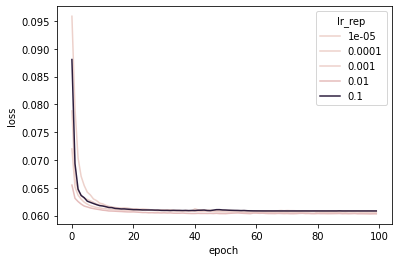

In [20]:
history = pd.read_csv(direc + 'history_B2.csv')

sns.lineplot(data=history, x='epoch', y='loss', hue='lr_rep')
plt.show()
# no clear trends

## Selecting a model based on *Radford et al. 2016*

### 1st run

In [21]:
# channel size
channel_options = [16,32,64,128]

# size of latent dimension to project CNN output to
latent_dimension_options = [2, 8, 32, 64, 128, 256]

# learning rates for decoder and representation
lr_decoder_options = [1e-2,1e-3,1e-4,1e-5]
lr_rep_options = [1e-2,1e-3,1e-4,1e-5]

# weight decay for adam optimizer
wd = 1e-5

n_epochs = 10

In [23]:
count = 0
for l in latent_dimension_options:
  for c in channel_options:
    for lr_decoder in lr_decoder_options:
      for lr_rep in lr_rep_options:
        decoder = DecoderFC(latent_dim=l,c=c)

        train_history = trainDecoder(trainloader, nepocs=n_epochs,
                                            latent_dim=l, decoder=decoder,
                                            lr=lr_decoder, lr_rep=lr_rep, wd=wd, mom=0.9,
                                            indices_images=trainset_1.indices)
        history_out = pd.DataFrame({'loss': train_history,
                                    'epoch': range(n_epochs),
                                    'id': count,
                                    'capacity': c,
                                    'latent': l,
                                    'lr_decoder': lr_decoder,
                                    'lr_rep': lr_rep
                                    })
        if count == 0:
          history_out.to_csv(direc + 'history_C.csv',index=False)
        else:
          history_out.to_csv(direc + 'history_C.csv',mode='a',index=False,header=False)
        
        count += 1

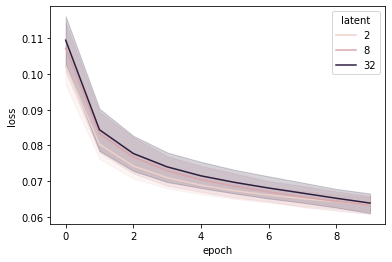

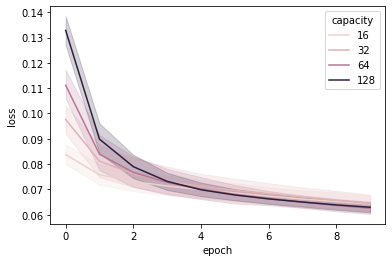

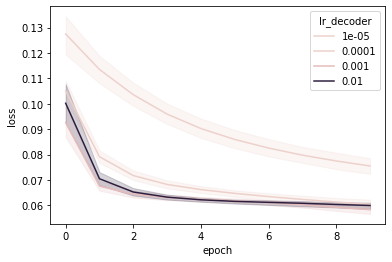

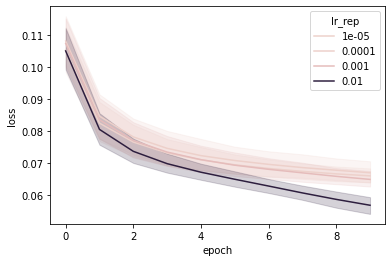

In [8]:
history = pd.read_csv(direc + 'history_C.csv')

sns.lineplot(data=history, x='epoch', y='loss', hue='latent')
plt.show()

sns.lineplot(data=history, x='epoch', y='loss', hue='capacity')
plt.show()

sns.lineplot(data=history, x='epoch', y='loss', hue='lr_decoder')
plt.show()

sns.lineplot(data=history, x='epoch', y='loss', hue='lr_rep')
plt.show()

Models with a learning rate for the representation of 0.01 seem the most promising in their slope and final loss.

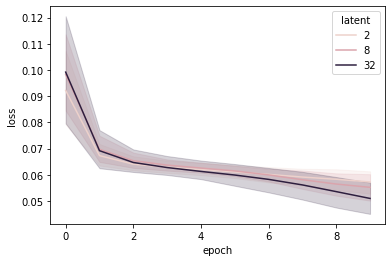

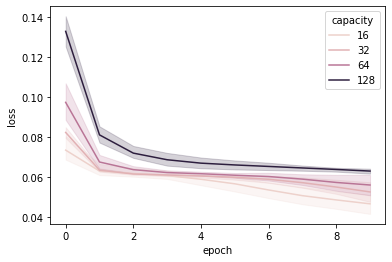

In [9]:
sns.lineplot(data=history[(history['lr_rep']==0.01) & (history['lr_decoder']>=0.001)], x='epoch', y='loss', hue='latent')
plt.show()

sns.lineplot(data=history[(history['lr_rep']==0.01) & (history['lr_decoder']>=0.001)], x='epoch', y='loss', hue='capacity')
plt.show()

Here, larger latent dimensions seem to improve performance. They should be increased further. For capacities, the opposite may be the case (>32 decreases performance).

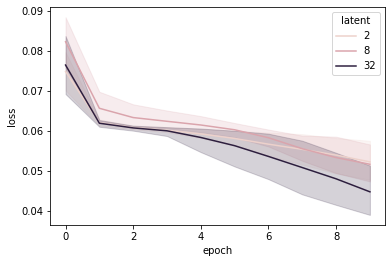

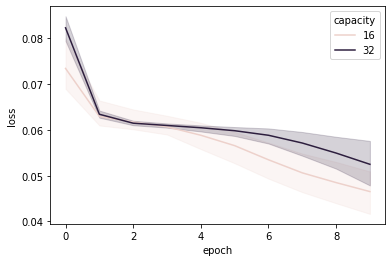

In [12]:
sns.lineplot(data=history[(history['lr_rep']==0.01) & (history['lr_decoder']>=0.001) & (history['capacity'] <= 32)], x='epoch', y='loss', hue='latent')
plt.show()

sns.lineplot(data=history[(history['lr_rep']==0.01) & (history['lr_decoder']>=0.001) & (history['capacity'] <= 32)], x='epoch', y='loss', hue='capacity')
plt.show()

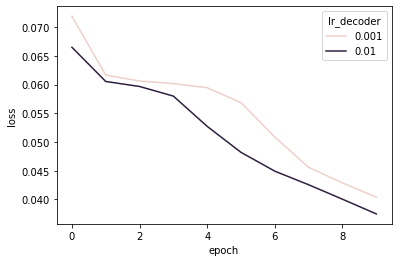

In [13]:
sns.lineplot(data=history[(history['lr_rep']==0.01) & (history['lr_decoder']>=0.001) & (history['capacity'] == 16) & (history['latent'] == 32)], x='epoch', y='loss', hue='lr_decoder')
plt.show()

### 2nd run: regularization

## Final optimization

After searching for best-performing architectures and hyperparameters from the two publications introduced, we arrived at the conclusion that the simple model based on *Radford et al. 2016* serves as a better decoder for CIFAR10.

We will hereafter show that additionally removing the fully connected layer in the beginning, determining the latent dimension, benefits model performance.

In [23]:
lr_decoder_options = [1e-2,1e-3,1e-4]
lr_rep_options = [1e-1,1e-2,1e-3]

capacity_options = [16,32,64] # we do not increase this as it would not allow for a lower-dimensional representation

wd = 1e-5

n_epochs = 50 # since we are testing fewer models, we can do so for longer and with more samples

Lr_decoder: 0.01, lr_rep: 0.1, capacity: 16


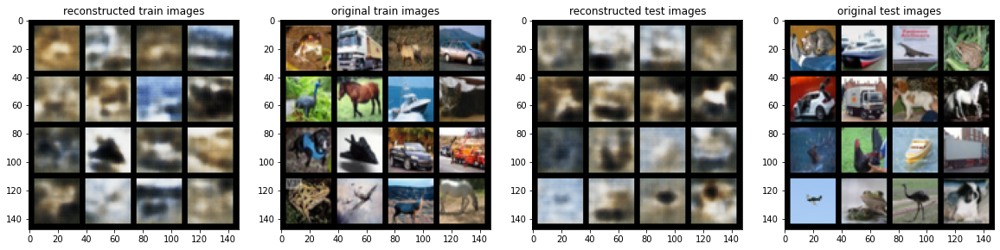

Lr_decoder: 0.01, lr_rep: 0.1, capacity: 32


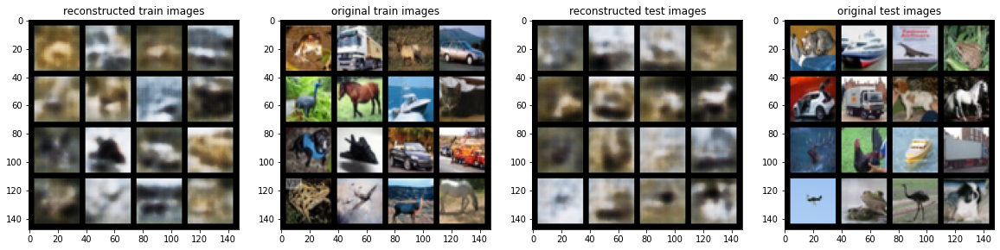

Lr_decoder: 0.01, lr_rep: 0.1, capacity: 64


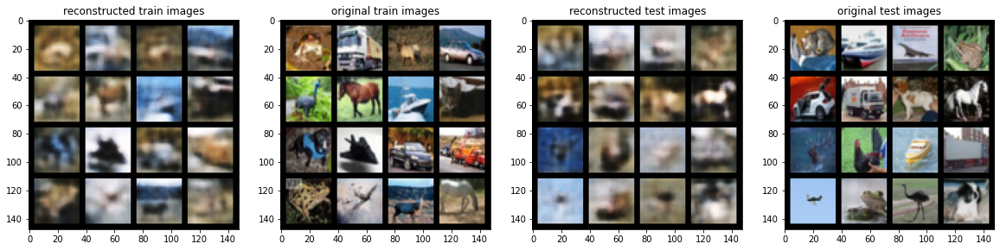

Lr_decoder: 0.01, lr_rep: 0.01, capacity: 16


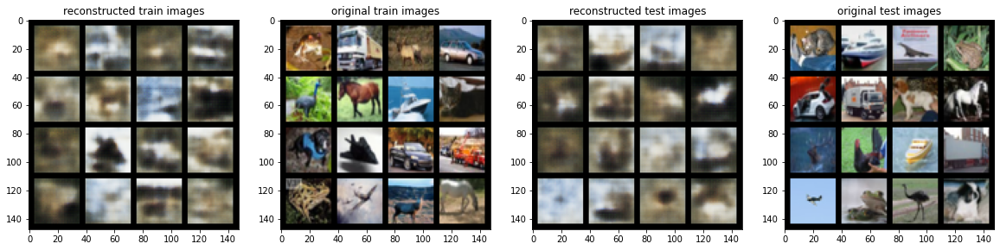

Lr_decoder: 0.01, lr_rep: 0.01, capacity: 32


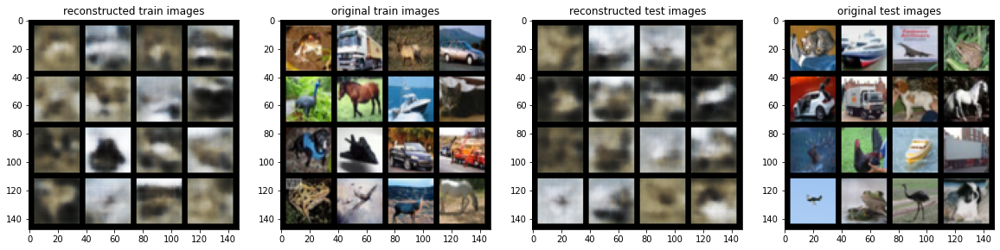

Lr_decoder: 0.01, lr_rep: 0.01, capacity: 64


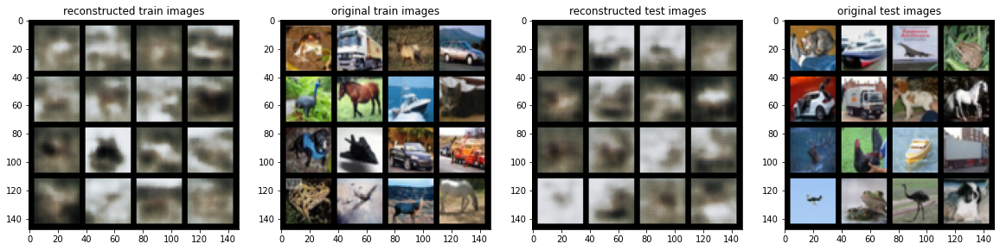

Lr_decoder: 0.01, lr_rep: 0.001, capacity: 16


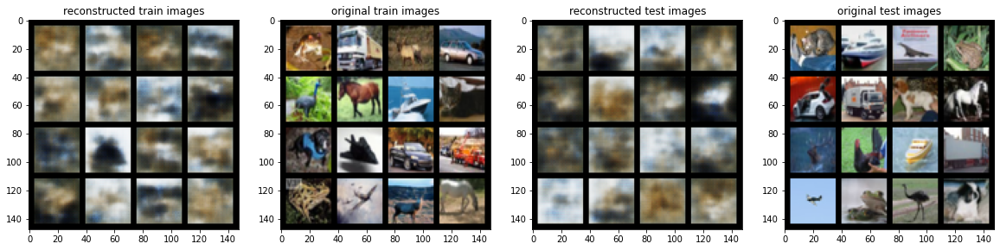

Lr_decoder: 0.01, lr_rep: 0.001, capacity: 32


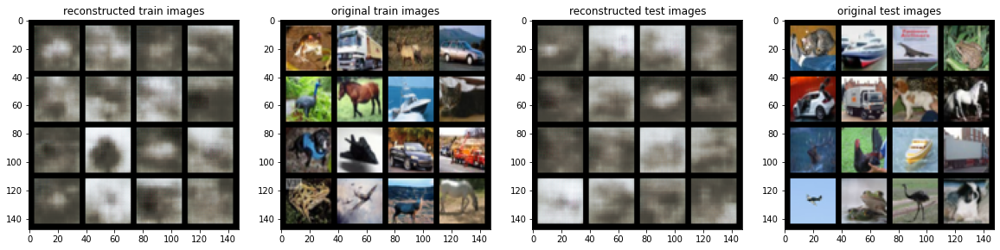

Lr_decoder: 0.01, lr_rep: 0.001, capacity: 64


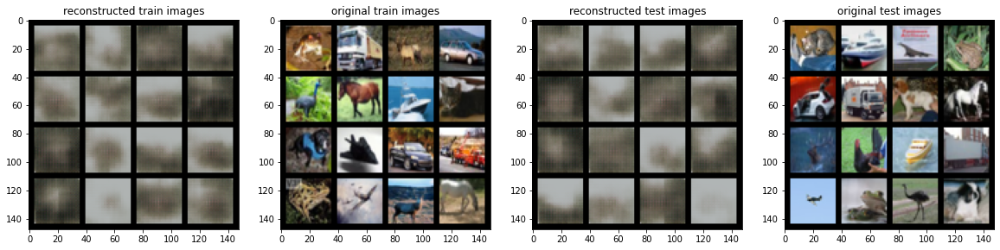

Lr_decoder: 0.001, lr_rep: 0.1, capacity: 16


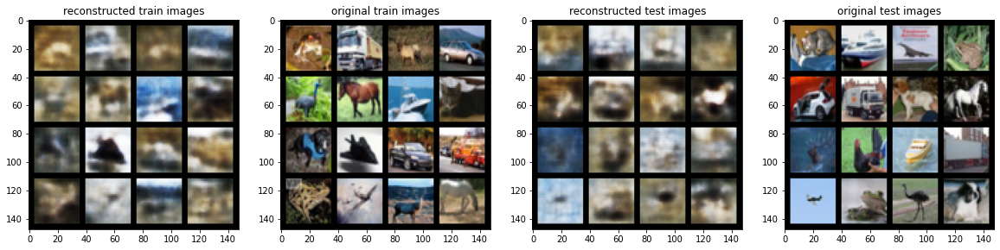

Lr_decoder: 0.001, lr_rep: 0.1, capacity: 32


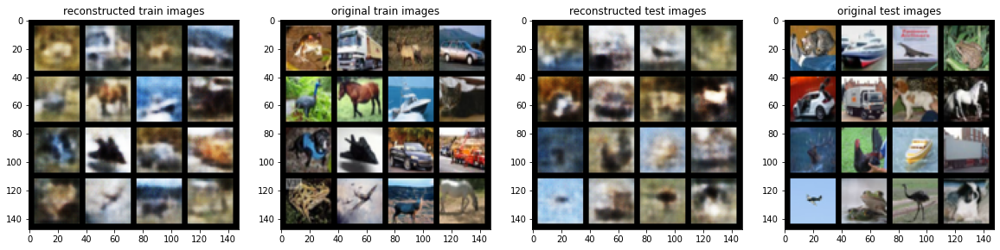

Lr_decoder: 0.001, lr_rep: 0.1, capacity: 64


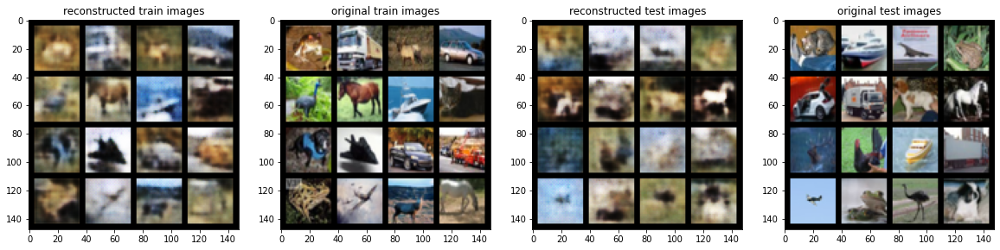

Lr_decoder: 0.001, lr_rep: 0.01, capacity: 16


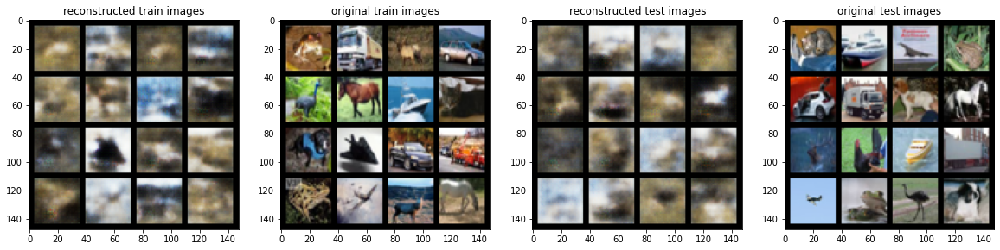

Lr_decoder: 0.001, lr_rep: 0.01, capacity: 32


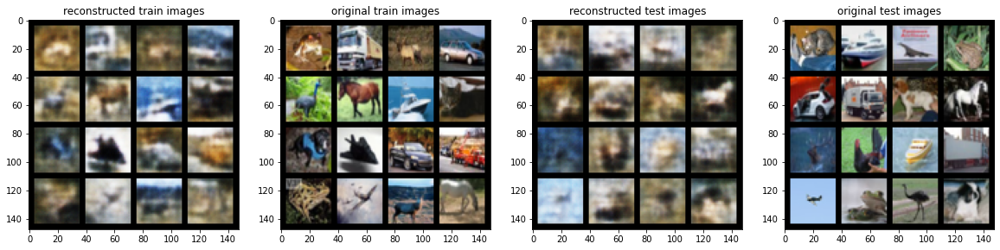

Lr_decoder: 0.001, lr_rep: 0.01, capacity: 64


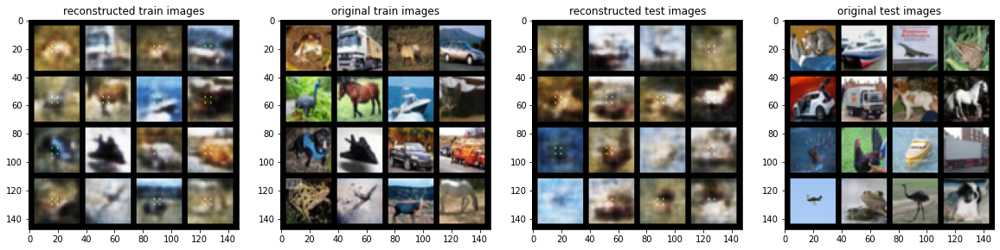

Lr_decoder: 0.001, lr_rep: 0.001, capacity: 16


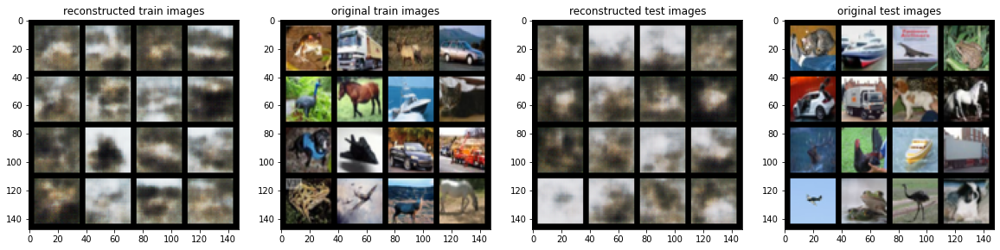

Lr_decoder: 0.001, lr_rep: 0.001, capacity: 32


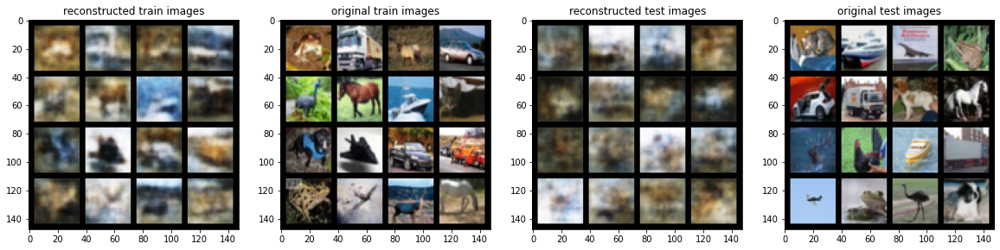

Lr_decoder: 0.001, lr_rep: 0.001, capacity: 64


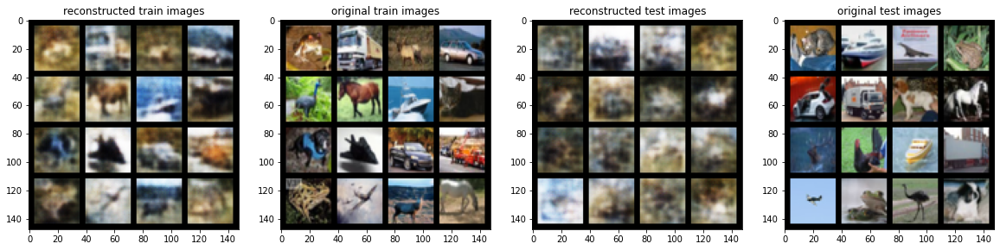

Lr_decoder: 0.0001, lr_rep: 0.1, capacity: 16


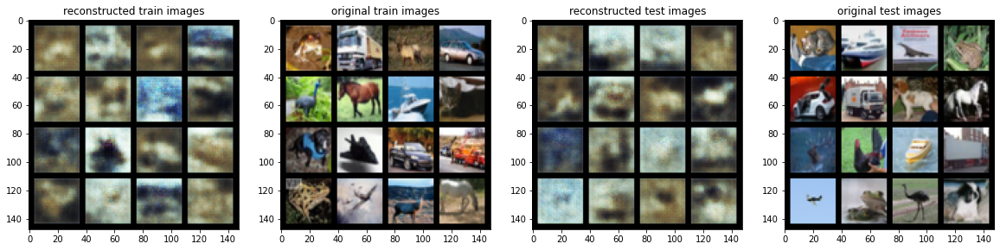

Lr_decoder: 0.0001, lr_rep: 0.1, capacity: 32


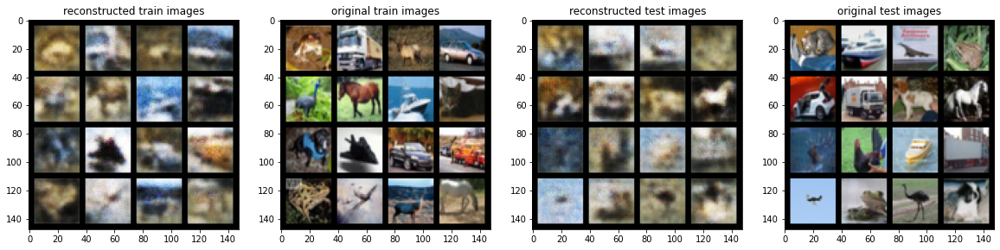

Lr_decoder: 0.0001, lr_rep: 0.1, capacity: 64


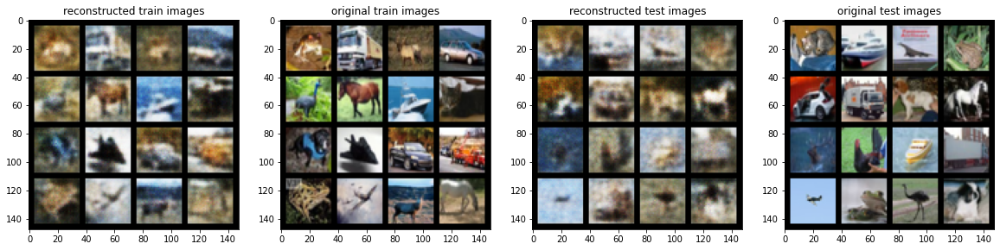

Lr_decoder: 0.0001, lr_rep: 0.01, capacity: 16


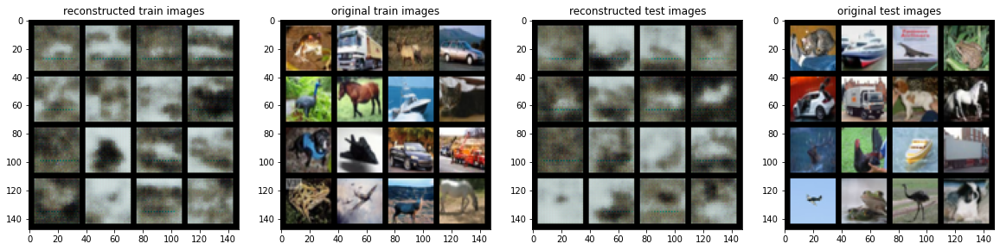

Lr_decoder: 0.0001, lr_rep: 0.01, capacity: 32


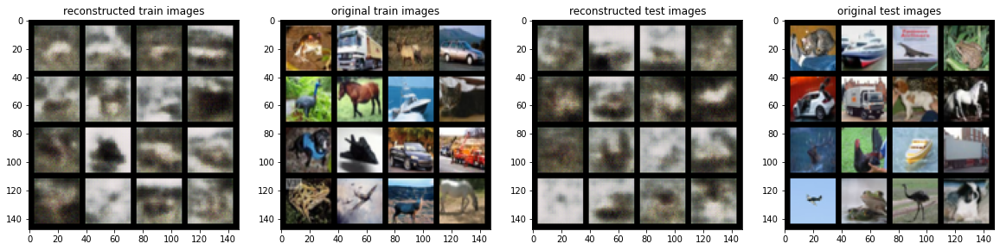

Lr_decoder: 0.0001, lr_rep: 0.01, capacity: 64


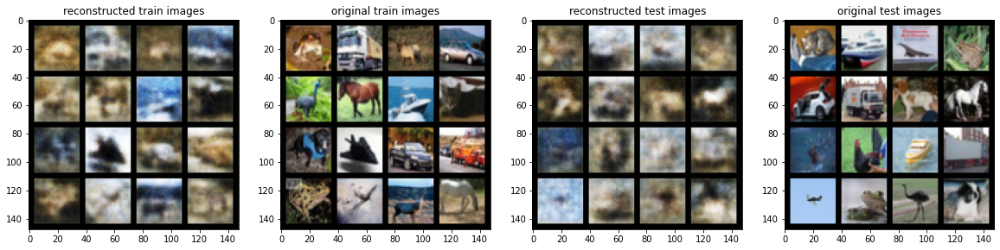

Lr_decoder: 0.0001, lr_rep: 0.001, capacity: 16


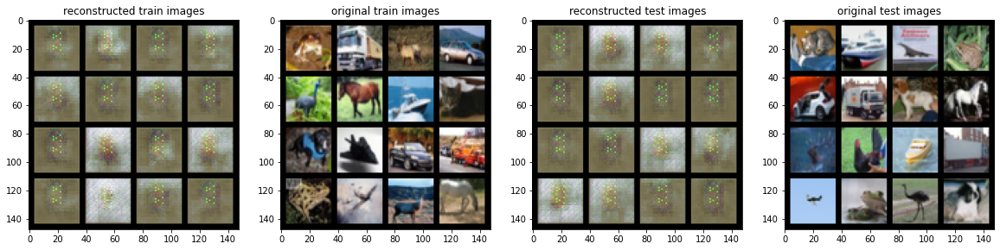

Lr_decoder: 0.0001, lr_rep: 0.001, capacity: 32


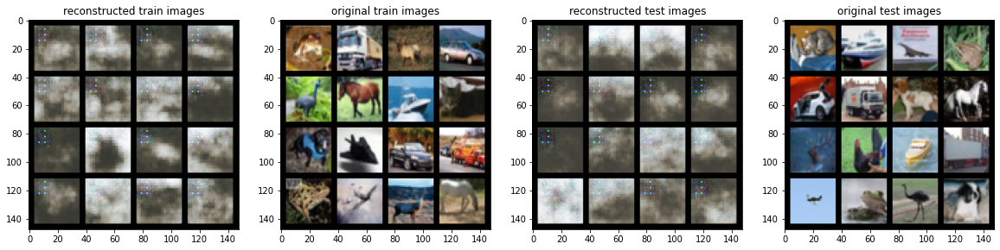

Lr_decoder: 0.0001, lr_rep: 0.001, capacity: 64


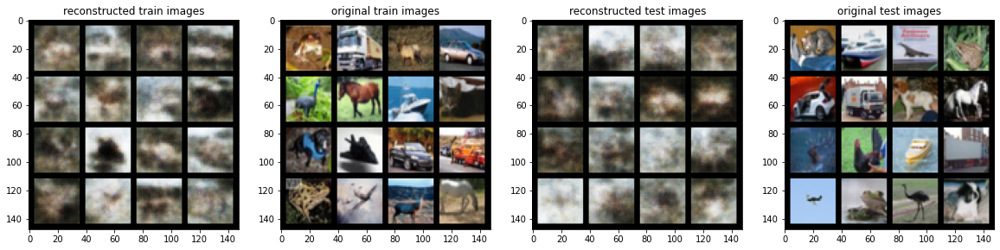

In [24]:
set_random_seed(0)

count = 0
for lr_decoder in lr_decoder_options:
  for lr_rep in lr_rep_options:
    for capacity in capacity_options:
      print('Lr_decoder: {}, lr_rep: {}, capacity: {}'.format(lr_decoder, lr_rep, capacity))
      decoder = Decoder(c=capacity)
      decoder, rep, test_rep, history = trainDecoder(data=trainloader, test_data=testloader, nepocs=n_epochs,
                                            latent_dim=capacity*4, decoder=decoder,
                                            lr=lr_decoder, lr_rep=lr_rep, wd=wd, mom=0.9,plt_img=1,
                                            indices_images=trainset_1.indices, indices_images_test=testset_1.indices)
      history['lr_decoder'] = lr_decoder
      history['lr_rep'] = lr_rep
      history['capacity'] = capacity
      if count == 0:
        history.to_csv(direc + 'history_decoder_appendix.csv',index=False)
      else:
        history.to_csv(direc + 'history_decoder_appendix.csv',mode='a',index=False,header=False)
      count += 1
      rep_recon_plot_decoder(train_set=trainset_1, test_set=testset_1,
                             decoder=decoder, rep=rep, test_rep=test_rep,
                             data_type='subset',
                             indices_images=trainset_1.indices,indices_images_test=testset_1.indices)

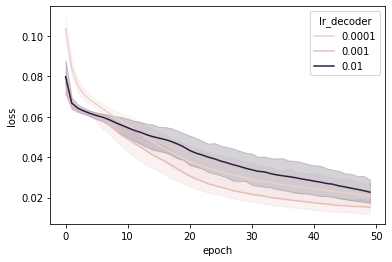

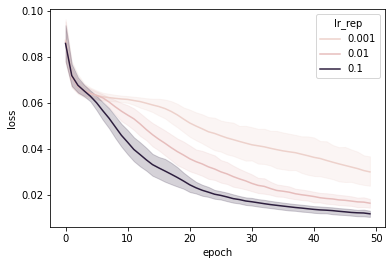

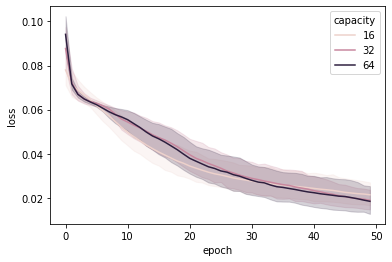

In [50]:
history = pd.read_csv(direc + 'history_decoder_appendix.csv')

sns.lineplot(data=history, x='epoch', y='loss', hue='lr_decoder')
plt.show()

sns.lineplot(data=history, x='epoch', y='loss', hue='lr_rep')
plt.show()

sns.lineplot(data=history, x='epoch', y='loss', hue='capacity')
plt.show()

While capacity shows no trend in learning curves, learning rates are suggested to achieve best results for lr_decoder 0.001 or 0.0001 (smoother) and lr_rep 0.1.

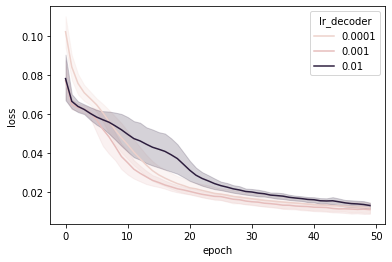

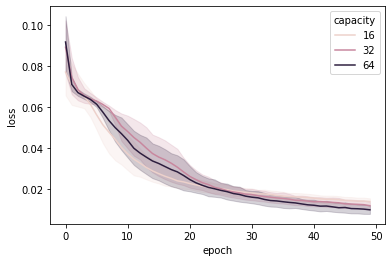

In [51]:
sns.lineplot(data=history[history['lr_rep']==1e-1], x='epoch', y='loss', hue='lr_decoder')
plt.show()

sns.lineplot(data=history[history['lr_rep']==1e-1], x='epoch', y='loss', hue='capacity')
plt.show()

Smoothness and steepness of lr_decoder 1e-4 seem most promising.

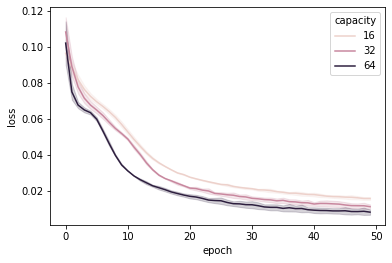

In [52]:
sns.lineplot(data=history[(history['lr_decoder']==1e-4) & (history['lr_rep']==1e-1)], x='epoch', y='loss', hue='capacity')
plt.show()

Choosing capacity of 64 doe to fast convergence and lowest loss.

# Model Search for Autoencoder

Even though the blocks-approach was clearly outperformed by the simpler DCGAN architecture for the decoder, we ran a brief search over this design space, too, for the autoencoder. We did this to reduce performance bias in favour of the decoder.

Instead of aiming for a 1-dimensional representation vector, we stop at representations of shape *(channels, 2, 2)* and *(channels, 4, 4)*. It is common knowledge in the CIFAR10 autoencoder community that reducing the pixel dimensions too much (some say <= *4x4*) results in bad performance.

## *Radosavovic et al. 2020*

We introduce another restriction to the combination of channel multiplier, number of stages and representation matrix size. We do this to limit the latent dimension to reasonable numbers of lower dimension than the input space.

We only test kernel size 3 with stride 1 as proposed in the paper.
The number of blocks is restricted to 14 and 15, so we end up with representations of shape *(channels, 2, 2)* and *(channels, 4, 4)*.

In [14]:
for m in [2,3]:
  print('multiplier: {}'.format(m))
  for i in range(1,10):
    print('stages: {}, filters in the end: {}, hidden dimensions {} or {}'.format(i, 3*i**m, (3*i**m)*2**2, (3*i**m)*4**2))

multiplier: 2
stages: 1, filters in the end: 3, hidden dimensions 12 or 48
stages: 2, filters in the end: 12, hidden dimensions 48 or 192
stages: 3, filters in the end: 27, hidden dimensions 108 or 432
stages: 4, filters in the end: 48, hidden dimensions 192 or 768
stages: 5, filters in the end: 75, hidden dimensions 300 or 1200
stages: 6, filters in the end: 108, hidden dimensions 432 or 1728
stages: 7, filters in the end: 147, hidden dimensions 588 or 2352
stages: 8, filters in the end: 192, hidden dimensions 768 or 3072
stages: 9, filters in the end: 243, hidden dimensions 972 or 3888
multiplier: 3
stages: 1, filters in the end: 3, hidden dimensions 12 or 48
stages: 2, filters in the end: 24, hidden dimensions 96 or 384
stages: 3, filters in the end: 81, hidden dimensions 324 or 1296
stages: 4, filters in the end: 192, hidden dimensions 768 or 3072
stages: 5, filters in the end: 375, hidden dimensions 1500 or 6000
stages: 6, filters in the end: 648, hidden dimensions 2592 or 10368
s

combinatorical rules for multipliers and stages:
- m=2: 3-8 stages for block sum 15, 2-6 stages for block sum 14
- m=3: 2-5 and 2-4, respectively

### 1st run

In [25]:
lr = 1e-3
wd = 1e-5
n_epochs = 10

In [26]:
# 3 stages

s = 3
stage3_list = []

for b_sum in [14,15]:
  max_b1 = round_down(b_sum/s)
  for i in range(1,max_b1+1):
    temp_list = [i]
    stage3_list.append(fill_block_position(s-1,b_sum,i,i,temp_list))

count = 0
for m in [2,3]:
  for b in stage3_list:
    hidden = ((32-sum(b)*2)**2)*3*m**len(b)
    mtrx_size = 32-sum(b)*2
    model = AE_Blocks(stages=len(b),blocks=b,multiplier=m,start_chanl=3)
    train_history = trainAE(trainloader, testloader, nepocs=n_epochs,model=model,
                          lr=lr, wd=wd, indices_images=trainset_1.indices,
                          indices_images_test=testset_1.indices,pr=0)
    train_history['stages'] = len(b)
    train_history['blocks'] = str(b)
    train_history['multiplier'] = m
    if count == 0:
      train_history.to_csv(direc + 'history_AE_1.csv',index=False)
    else:
      train_history.to_csv(direc + 'history_AE_1.csv',mode='a',index=False,header=False)
    model = None
    count += 1

In [ ]:
# 4 stages

s = 4
stage4_list = []

for b_sum in [14,15]:
  max_b1 = round_down(b_sum/s)
  for i in range(1,max_b1+1):
    max_b2 = round_down((b_sum-i)/(s-1))
    for j in range(i,max_b2+1):
      temp_list = [i,j]
      stage4_list.append(fill_block_position(s-2,b_sum,j,i+j,temp_list))

count = 0
for m in [2,3]:
  for b in stage4_list:
    hidden = ((32-sum(b)*2)**2)*3*m**len(b)
    mtrx_size = 32-sum(b)*2
    model = AE_Blocks(stages=len(b),blocks=b,multiplier=m,start_chanl=3)
    train_history = trainAE(trainloader, testloader, nepocs=n_epochs,model=model,
                          lr=lr, wd=wd, indices_images=trainset_1.indices,
                          indices_images_test=testset_1.indices,pr=0)
    train_history['stages'] = len(b)
    train_history['blocks'] = str(b)
    train_history['multiplier'] = m
    train_history.to_csv(direc + 'history_AE_1.csv',mode='a',index=False,header=False)
    model = None
    count += 1

In [ ]:
# 5 stages

s = 5
stage5_list = []

for b_sum in [14,15]:
  max_b1 = round_down(b_sum/s)
  for i in range(1,max_b1+1):
    max_b2 = round_down((b_sum-i)/(s-1))
    for j in range(i,max_b2+1):
      max_b3 = round_down((b_sum-i-j)/(s-2))
      for l in range(j, max_b3):
        temp_list = [i,j,l]
        stage5_list.append(fill_block_position(s-3,b_sum,l,i+j+l,temp_list))

count = 0
m = 2
for b in stage5_list:
  hidden = ((32-sum(b)*2)**2)*3*m**len(b)
  mtrx_size = 32-sum(b)*2
  model = AE_Blocks(stages=len(b),blocks=b,multiplier=m,start_chanl=3)
  train_history = trainAE(trainloader, testloader, nepocs=n_epochs,model=model,
                        lr=lr, wd=wd, indices_images=trainset_1.indices,
                        indices_images_test=testset_1.indices,pr=0)
  train_history['stages'] = len(b)
  train_history['blocks'] = str(b)
  train_history['multiplier'] = m
  train_history.to_csv(direc + 'history_AE_1.csv',mode='a',index=False,header=False)
  model = None
  count += 1

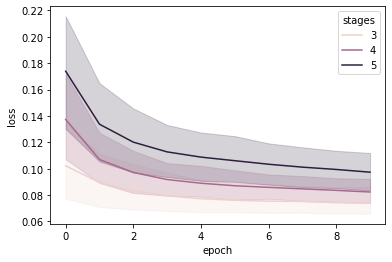

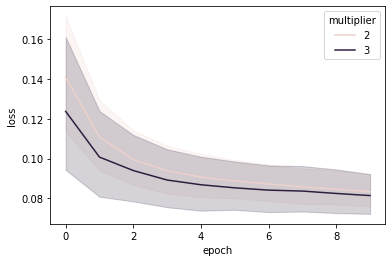

In [15]:
history = pd.read_csv(direc + 'history_AE_1.csv')
history = history[history['type']=='test']

sns.lineplot(data=history, x='epoch', y='loss', hue='stages')
plt.show()

sns.lineplot(data=history, x='epoch', y='loss', hue='multiplier')
plt.show()

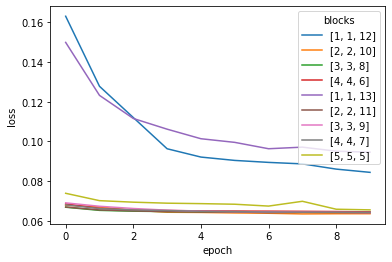

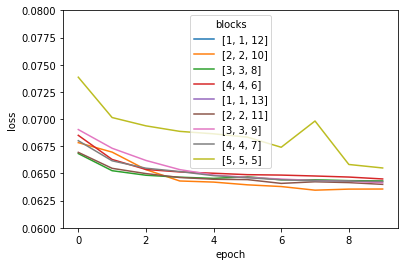

In [16]:
sns.lineplot(data=history[(history['stages']==3) & (history['multiplier']==3)], x='epoch', y='loss', hue='blocks')
plt.show()

sns.lineplot(data=history[(history['stages']==3) & (history['multiplier']==3)], x='epoch', y='loss', hue='blocks')
plt.ylim((0.06,0.08))
plt.show()

They all show a bad performance. Before continuing with this approach, we test the simpler DCGAN structure with a larger bottleneck.

blocks: [1, 1, 12], hidden dim 1296, matrix: 4x4
params: 981000
load_d: 1.7196, load_e: 3.1315


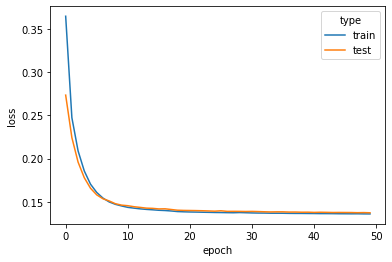

train loss 0.1359, test loss 0.1372


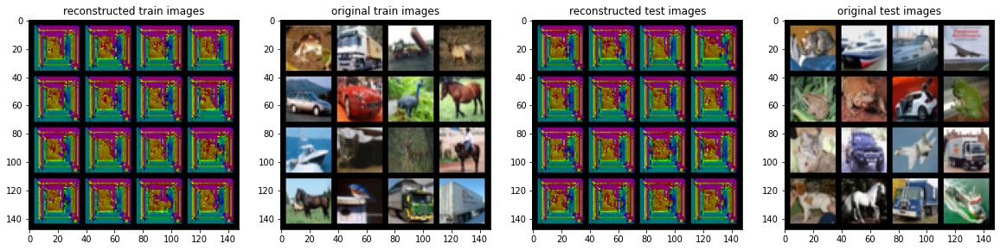

In [54]:
n_epochs = 50
m = 3
b = [1,1,12]

hidden = ((32-sum(b)*2)**2)*3*m**len(b)
mtrx_size = 32-sum(b)*2
print('blocks: {}, hidden dim {}, matrix: {}x{}'.format(b,hidden,mtrx_size,mtrx_size))
model = AE_Blocks(stages=len(b),blocks=b,multiplier=m,start_chanl=3)
print('params: {}'.format(count_params(model)))
print('load_d: {}, load_e: {}'.format(load_d(trainset_1.__len__(),32*32*3,hidden,0.5*count_params(model)),load_e(trainset_1.__len__(),32*32*3,count_params(model))))
autoencoder, train_history = trainAE(trainloader, testloader, nepocs=n_epochs,model=model,
                      lr=lr, wd=wd, indices_images=trainset_1.indices,
                      indices_images_test=testset_1.indices,pr=1,plt_img=1)
rep_recon_plot_ae(train_set=trainset_1,test_set=testset_1, model=autoencoder, data_type='subset')

## *Radford et al. 2016*

We start out with the DCGAN architecture modified in our decoder search, but stop at the *4x4* pixel level.

In [46]:
lr_options = [1e-2,1e-3,1e-4,1e-5]
capacity_options = [16,32,64]

wd = 1e-5

n_epochs = 50

Lr: 0.01, capacity: 16


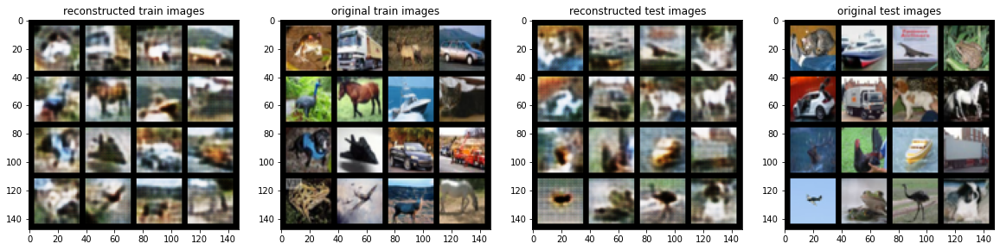

Lr: 0.01, capacity: 32


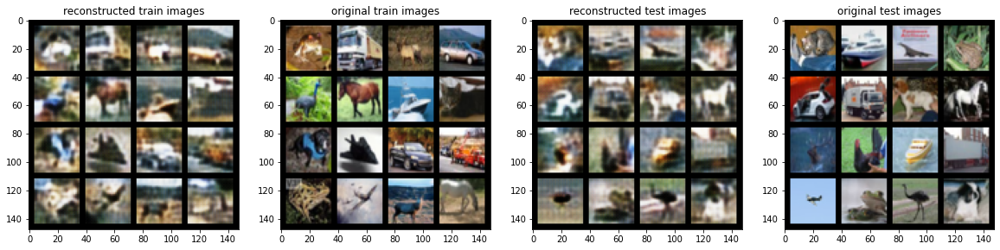

Lr: 0.01, capacity: 64


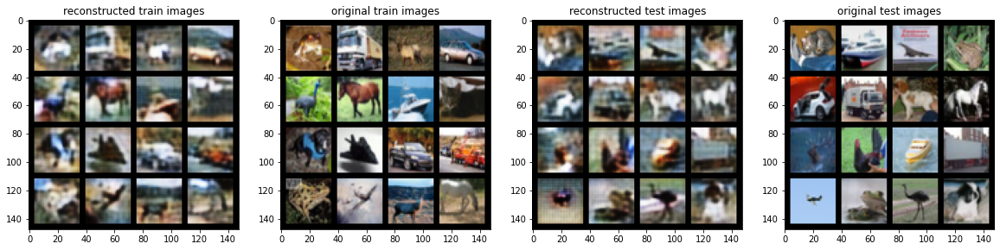

Lr: 0.001, capacity: 16


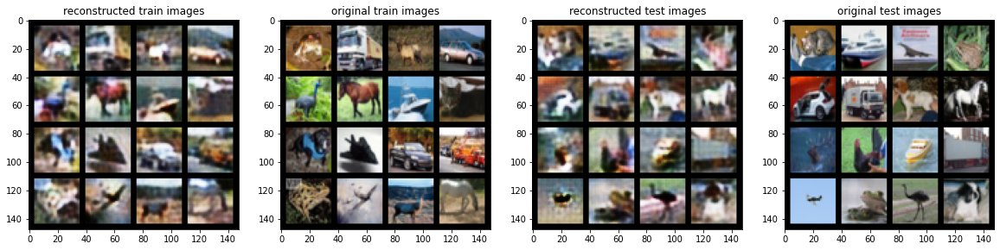

Lr: 0.001, capacity: 32


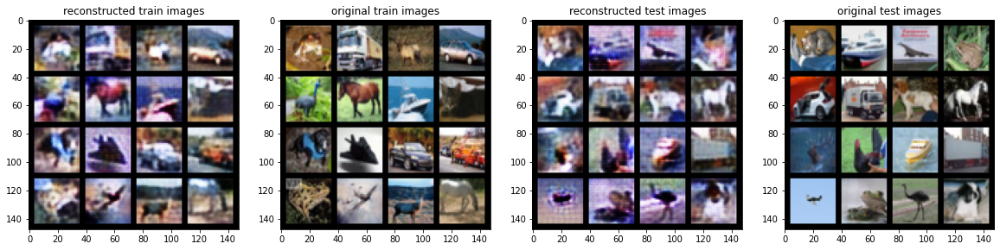

Lr: 0.001, capacity: 64


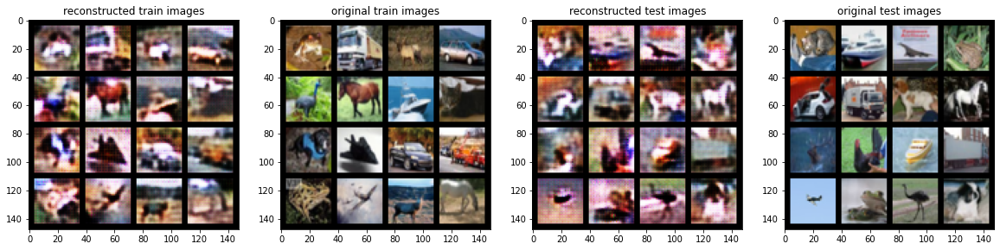

Lr: 0.0001, capacity: 16


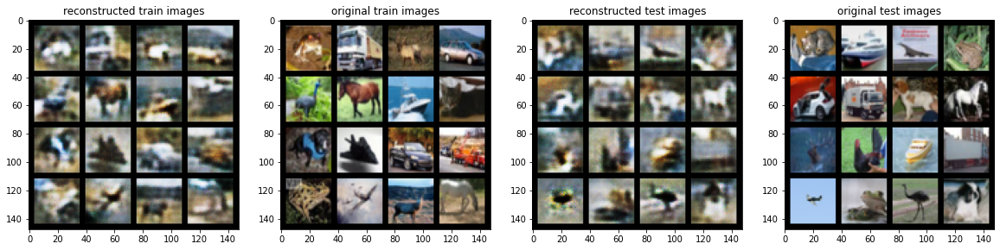

Lr: 0.0001, capacity: 32


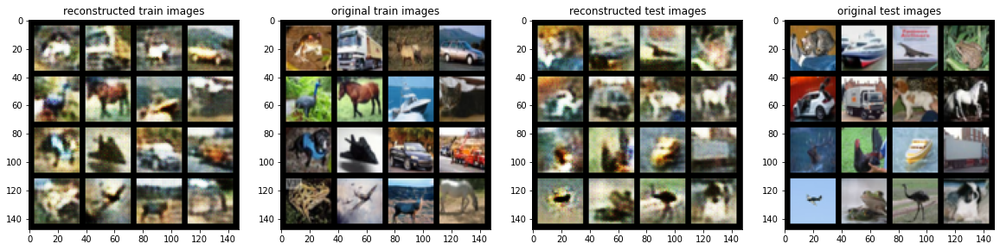

Lr: 0.0001, capacity: 64


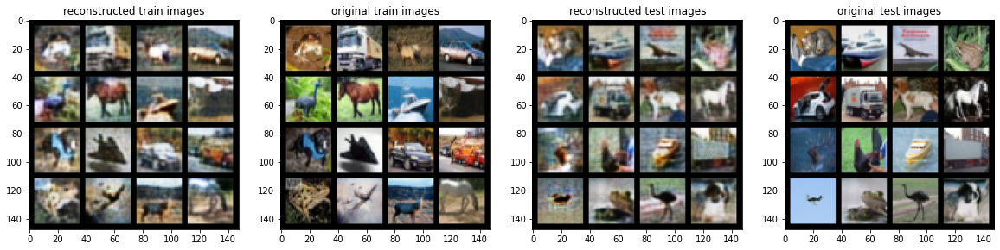

Lr: 1e-05, capacity: 16


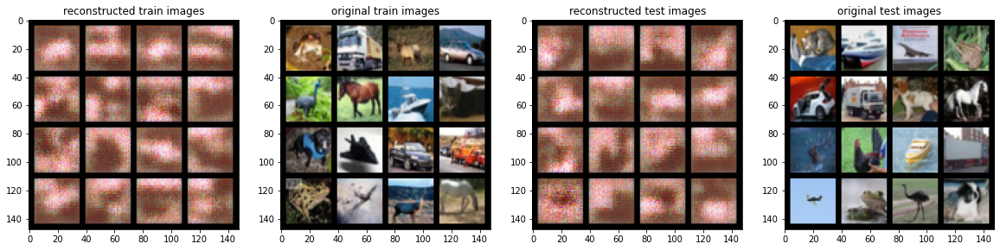

Lr: 1e-05, capacity: 32


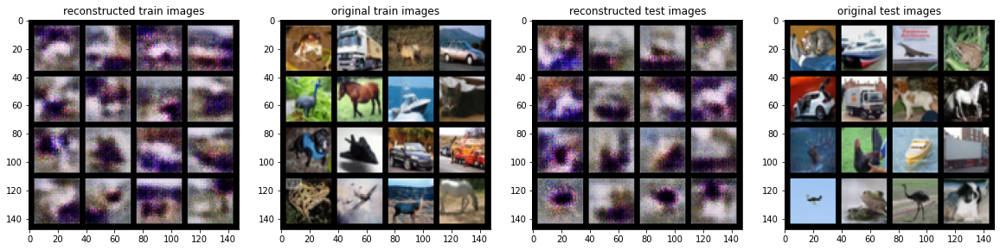

Lr: 1e-05, capacity: 64


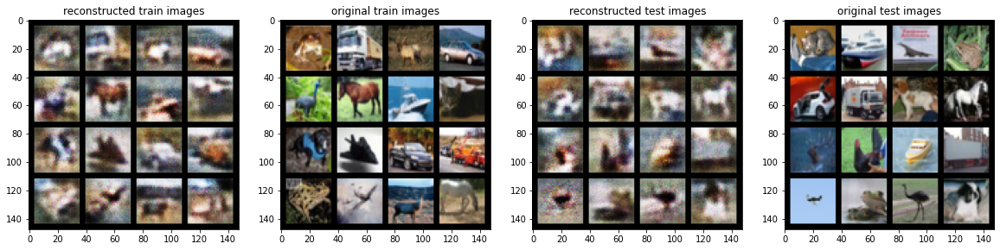

In [47]:
set_random_seed(0)

count = 0
for lr in lr_options:
  for capacity in capacity_options:
    print('Lr: {}, capacity: {}'.format(lr, capacity))
    autoencoder = AE_shallow(c=capacity)
    autoencoder, history = trainAE(trainloader, testloader, nepocs=n_epochs, model=autoencoder, lr=lr, wd=wd, plt_img=1)
    history['lr'] = lr
    history['capacity'] = capacity
    if count == 0:
      history.to_csv(direc + 'history_AE_2.csv',index=False)
    else:
      history.to_csv(direc + 'history_AE_2.csv',mode='a',index=False,header=False)
    count += 1
    rep_recon_plot_ae(train_set=trainset_1,test_set=testset_1, model=autoencoder,data_type='subset',
                      indices_images=trainset_1.indices,indices_images_test=testset_1.indices)

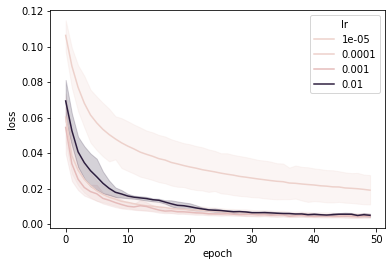

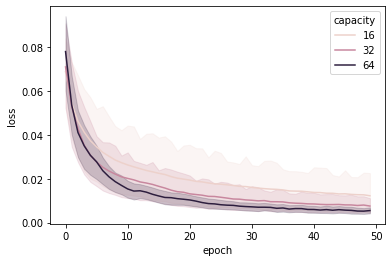

In [48]:
history = pd.read_csv(direc + 'history_AE_2.csv')

sns.lineplot(data=history, x='epoch', y='loss', hue='lr')
plt.show()

sns.lineplot(data=history, x='epoch', y='loss', hue='capacity')
plt.show()

Even though a capacity of 16 shows the highest average loss, the others result in too high representation dimensions (> 2000 compared to image dimension of 3072).

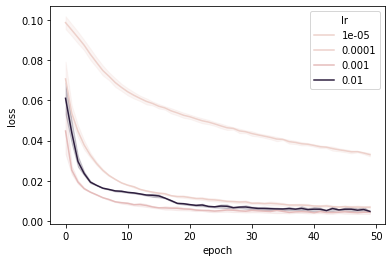

In [49]:
sns.lineplot(data=history[history['capacity']==16], x='epoch', y='loss', hue='lr')
plt.show()

Both learning rates 1e-3 and 1e-4 show smooth curves and result in similar losses after 50 epochs, but the slope of lr 1e-4 seems more promising.

## Final assessment

The simpler DCGAN-inspired architecture from *Radford et al. 2016* again performs better and is chosen to train an autoencoder on CIFAR10.